# Install

In [1]:
import distutils.util
import os
import subprocess

if subprocess.run('nvidia-smi').returncode:
  raise RuntimeError(
      'Cannot communicate with GPU. '
      'Make sure you are using a GPU Colab runtime. '
      'Go to the Runtime menu and select Choose runtime type.')

# Add an ICD config so that glvnd can pick up the Nvidia EGL driver.
# This is usually installed as part of an Nvidia driver package, but the Colab
# kernel doesn't install its driver via APT, and as a result the ICD is missing.
# (https://github.com/NVIDIA/libglvnd/blob/master/src/EGL/icd_enumeration.md)
NVIDIA_ICD_CONFIG_PATH = '/usr/share/glvnd/egl_vendor.d/10_nvidia.json'

if not os.path.exists(NVIDIA_ICD_CONFIG_PATH):
  with open(NVIDIA_ICD_CONFIG_PATH, 'w') as f:
    f.write("""{
    "file_format_version" : "1.0.0",
    "ICD" : {
        "library_path" : "libEGL_nvidia.so.0"
    }
}
""")

print('Runtime setup successful')

print('Installing dm_control...')

!pip install -q dm_control>=1.0.30

# Configure dm_control to use the EGL rendering backend (requires GPU)
%env MUJOCO_GL=egl

print('Checking that the dm_control installation succeeded...')

try:
  from dm_control import suite
  env = suite.load('cartpole', 'swingup')
  pixels = env.physics.render()
except Exception as e:
  raise e from RuntimeError(
      'Something went wrong during installation. Check the shell output above '
      'for more information.\n'
      'If using a hosted Colab runtime, make sure you enable GPU acceleration '
      'by going to the Runtime menu and selecting "Choose runtime type".')
else:
  del pixels, suite

!echo Installed dm_control $(pip show dm_control | grep -Po "(?<=Version: ).+")

Runtime setup successful
Installing dm_control...
env: MUJOCO_GL=egl
Checking that the dm_control installation succeeded...
Installed dm_control 1.0.30


# Imports

In [2]:
# The basic mujoco wrapper.
from dm_control import mujoco

# Access to enums and MuJoCo library functions.
from dm_control.mujoco.wrapper.mjbindings import enums
from dm_control.mujoco.wrapper.mjbindings import mjlib

# PyMJCF
from dm_control import mjcf

# Composer high level imports
from dm_control import composer
from dm_control.composer.observation import observable
from dm_control.composer import variation

# Imports for Composer tutorial example
from dm_control.composer.variation import distributions
from dm_control.composer.variation import noises
from dm_control.locomotion.arenas import floors

# Control Suite
from dm_control import suite

# Run through corridor example
from dm_control.locomotion.walkers import cmu_humanoid
from dm_control.locomotion.arenas import corridors as corridor_arenas
from dm_control.locomotion.tasks import corridors as corridor_tasks

# Manipulation
from dm_control import manipulation

# General
import copy
import os
import itertools
from IPython.display import clear_output
import numpy as np
import math

# Graphics-related
import matplotlib
import matplotlib.animation as animation
import matplotlib.pyplot as plt
from IPython.display import HTML
import PIL.Image
# Internal loading of video libraries.

# Use svg backend for figure rendering
%config InlineBackend.figure_format = 'svg'

/usr/local/lib/python3.11/dist-packages/matplotlib_inline/config.py:68: DeprecationWarning: InlineBackend._figure_format_changed is deprecated in traitlets 4.1: use @observe and @unobserve instead.
  def _figure_format_changed(self, name, old, new):


# Video helpers

In [3]:
# Font sizes
SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

# Inline video helper function
if os.environ.get('COLAB_NOTEBOOK_TEST', False):
  # We skip video generation during tests, as it is quite expensive.
  display_video = lambda *args, **kwargs: None
else:
  def display_video(frames, framerate=30):
    height, width, _ = frames[0].shape
    dpi = 70
    orig_backend = matplotlib.get_backend()
    matplotlib.use('Agg')  # Switch to headless 'Agg' to inhibit figure rendering.
    fig, ax = plt.subplots(1, 1, figsize=(width / dpi, height / dpi), dpi=dpi)
    matplotlib.use(orig_backend)  # Switch back to the original backend.
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.set_position([0, 0, 1, 1])
    im = ax.imshow(frames[0])
    def update(frame):
      im.set_data(frame)
      return [im]
    interval = 1000/framerate
    anim = animation.FuncAnimation(fig=fig, func=update, frames=frames,
                                   interval=interval, blit=True, repeat=False)
    return HTML(anim.to_html5_video())

# ---- Helper: render all cameras in a grid ----
def render_camera_grid(rendering):
    camera_ids = rendering["camera_ids"]
    cam_width = rendering["cam_width"]
    cam_height = rendering["cam_height"]

    grid_cols = rendering["grid_cols"]
    grid_rows = rendering["grid_rows"]


    # Render each camera view
    frames = [
        physics.render(camera_id=cam_id, width=cam_width, height=cam_height)
        for cam_id in camera_ids
    ]
    # Stack frames horizontally for each row
    rows = [
        np.hstack(frames[r * grid_cols:(r + 1) * grid_cols])
        for r in range(grid_rows)
    ]
    # Stack rows vertically to form the grid
    grid_image = np.vstack(rows)
    return grid_image

# Model definition

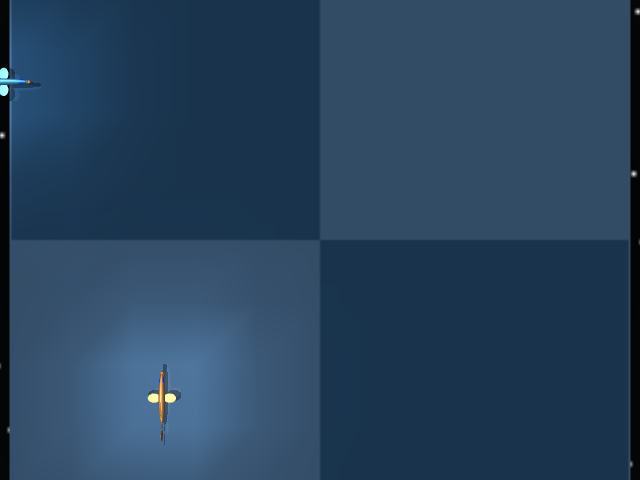

In [4]:
static_model = """
<mujoco model="fish">
  <visual>
    <headlight ambient=".4 .4 .4" diffuse=".8 .8 .8" specular="0.1 0.1 0.1" />
    <map znear=".01" />
    <quality shadowsize="2048" />
  </visual>

  <asset>
    <texture name="grid" type="2d" builtin="checker" rgb1=".1 .2 .3" rgb2=".2 .3 .4" width="300"
      height="300" mark="edge" markrgb=".2 .3 .4" />

    <texture name="skybox" type="skybox" builtin="gradient" rgb1=".4 .6 .8" rgb2="0 0 0"
      width="800"
      height="800" mark="random" markrgb="1 1 1" />

    <material name="grid" texture="grid" texrepeat="1 1" texuniform="true" reflectance=".2" />
    <material name="pursuit" rgba=".7 .5 .3 1" />
    <material name="evasion" rgba=".3 .6 .8 1" />
    <material name="self" rgba=".7 .5 .3 1" />
    <material name="self_default" rgba=".7 .5 .3 1" />
    <material name="self_highlight" rgba="0 .5 .3 1" />
    <material name="effector" rgba=".7 .4 .2 1" />
    <material name="effector_default" rgba=".7 .4 .2 1" />
    <material name="effector_highlight" rgba="0 .5 .3 1" />
    <material name="decoration" rgba=".3 .5 .7 1" />
    <material name="eye" rgba="0 .2 1 1" />
    <material name="target" rgba=".6 .3 .3 1" />
    <material name="target_default" rgba=".6 .3 .3 1" />
    <material name="target_highlight" rgba=".6 .3 .3 .4" />
    <material name="site" rgba=".5 .5 .5 .3" />
  </asset>

  <option timestep="0.004" density="5000">
    <flag gravity="disable" constraint="disable" />
  </option>

  <default>
    <general ctrllimited="true" />
    <default class="fish">
      <joint type="hinge" limited="false" range="-60 60" damping="2e-5" solreflimit=".1 1"
        solimplimit="0 .8 .1" />
      <geom material="self" />
    </default>
    <default class="fish_pursuit">
      <joint type="hinge" limited="false" range="-60 60" damping="2e-5" solreflimit=".1 1"
        solimplimit="0 .8 .1" />
      <geom material="pursuit" />
    </default>
    <default class="fish_evasion">
      <joint type="hinge" limited="false" range="-60 60" damping="2e-5" solreflimit=".1 1"
        solimplimit="0 .8 .1" />
      <geom material="evasion" />
    </default>
  </default>

  <worldbody>
    <camera name="tracking_top" pos="0 0 5.5" fovy="16" />
    <camera name="tracking_x" pos="-1 0 .2" xyaxes="0 -1 0 0.342 0 0.940" fovy="80" mode="trackcom" />
    <camera name="tracking_y" pos="0 -1 .2" xyaxes="1 0 0 0 0.342 0.940" fovy="80" mode="trackcom" />
    <geom name="ground" type="plane" size="1 1 .1" material="grid" />

    <body name="pursuit" pos="-.5 -.5 .1" childclass="fish_pursuit">
      <light name="pursuit_light" diffuse=".6 .6 .6" pos="0 0 0.5" dir="0 0 -1" specular=".3 .3 .3"
        mode="track" />
      <joint name="pursuit_root" type="free" damping="0" limited="false" />
      <site name="pursuit" size=".01" rgba="0 0 0 0" />
      <geom name="pursuit_eye" type="ellipsoid" pos="0 .055 .015" size=".008 .012 .008"
        euler="-10 0 0"
        material="eye" mass="0" />
      <camera name="pursuit_eye" pos="0 .06 .02" xyaxes="1 0 0 0 0 1" />
      <geom name="pursuit_mouth" type="capsule" fromto="0 .079 0 0 .07 0" size=".005"
        material="effector"
        mass="0" />
      <geom name="pursuit_lower_mouth" type="capsule" fromto="0 .079 -.004 0 .07 -.003" size=".0045"
        material="effector" mass="0" />
      <geom name="pursuit" type="ellipsoid" size=".01 .08 .04" mass="0" />
      <geom name="pursuit_back_fin" type="ellipsoid" size=".001 .03 .015" pos="0 -.03 .03"
        material="effector" mass="0" />
      <geom name="pursuit_massive" type="box" size=".002 .06 .03" group="4" />
      <body name="pursuit_tail1" pos="0 -.09 0">
        <joint name="pursuit_tail1" axis="0 0 1" pos="0 .01 0" />
        <joint name="pursuit_tail_twist" axis="0 1 0" pos="0 .01 0" range="-30 30" />
        <geom name="pursuit_tail1" type="ellipsoid" size=".001 .008 .016" />
        <body name="pursuit_tail2" pos="0 -.028 0">
          <joint name="pursuit_tail2" axis="0 0 1" pos="0 .02 0" stiffness="8e-5" />
          <geom name="pursuit_tail2" type="ellipsoid" size=".001 .018 .035" />
        </body>
      </body>
      <body name="pursuit_finright" pos=".01 0 0">
        <joint name="pursuit_finright_roll" axis="0 1 0" />
        <joint name="pursuit_finright_pitch" axis="1 0 0" pos="0 .005 0" />
        <geom name="pursuit_finright" type="ellipsoid" pos=".015 0 0" size=".02 .015 .001" />
      </body>
      <body name="pursuit_finleft" pos="-.01 0 0">
        <joint name="pursuit_finleft_roll" axis="0 1 0" />
        <joint name="pursuit_finleft_pitch" axis="1 0 0" pos="0 .005 0" />
        <geom name="pursuit_finleft" type="ellipsoid" pos="-.015 0 0" size=".02 .015 .001" />
      </body>
    </body>

    <body name="evasion" pos="-1 .5 .1" quat="-1 0 0 1" childclass="fish_evasion">
      <light name="evasion_light" diffuse=".6 .6 .6" pos="0 0 0.5" dir="0 0 -1" specular=".3 .3 .3"
        mode="track" />
      <joint name="evasion_root" type="free" damping="0" limited="false" />
      <site name="evasion" size=".01" rgba="0 0 0 0" />
      <geom name="evasion_eye" type="ellipsoid" pos="0 .055 .015" size=".008 .012 .008"
        euler="-10 0 0"
        material="eye" mass="0" />
      <camera name="evasion_eye" pos="0 .06 .02" xyaxes="1 0 0 0 0 1" />
      <geom name="evasion_mouth" type="capsule" fromto="0 .079 0 0 .07 0" size=".005"
        material="effector"
        mass="0" />
      <geom name="evasion_lower_mouth" type="capsule" fromto="0 .079 -.004 0 .07 -.003" size=".0045"
        material="effector" mass="0" />
      <geom name="evasion" type="ellipsoid" size=".01 .08 .04" mass="0" />
      <geom name="evasion_back_fin" type="ellipsoid" size=".001 .03 .015" pos="0 -.03 .03"
        material="effector" mass="0" />
      <geom name="evasion_massive" type="box" size=".002 .06 .03" group="4" />
      <body name="evasion_tail1" pos="0 -.09 0">
        <joint name="evasion_tail1" axis="0 0 1" pos="0 .01 0" />
        <joint name="evasion_tail_twist" axis="0 1 0" pos="0 .01 0" range="-30 30" />
        <geom name="evasion_tail1" type="ellipsoid" size=".001 .008 .016" />
        <body name="evasion_tail2" pos="0 -.028 0">
          <joint name="evasion_tail2" axis="0 0 1" pos="0 .02 0" stiffness="8e-5" />
          <geom name="evasion_tail2" type="ellipsoid" size=".001 .018 .035" />
        </body>
      </body>
      <body name="evasion_finright" pos=".01 0 0">
        <joint name="evasion_finright_roll" axis="0 1 0" />
        <joint name="evasion_finright_pitch" axis="1 0 0" pos="0 .005 0" />
        <geom name="evasion_finright" type="ellipsoid" pos=".015 0 0" size=".02 .015 .001" />
      </body>
      <body name="evasion_finleft" pos="-.01 0 0">
        <joint name="evasion_finleft_roll" axis="0 1 0" />
        <joint name="evasion_finleft_pitch" axis="1 0 0" pos="0 .005 0" />
        <geom name="evasion_finleft" type="ellipsoid" pos="-.015 0 0" size=".02 .015 .001" />
      </body>
    </body>
  </worldbody>

  <tendon>
    <fixed name="pursuit_fins_flap">
      <joint joint="pursuit_finleft_roll" coef="-.5" />
      <joint joint="pursuit_finright_roll" coef=".5" />
    </fixed>
    <fixed name="pursuit_fins_sym" stiffness="1e-4">
      <joint joint="pursuit_finleft_roll" coef=".5" />
      <joint joint="pursuit_finright_roll" coef=".5" />
    </fixed>

    <fixed name="evasion_fins_flap">
      <joint joint="evasion_finleft_roll" coef="-.5" />
      <joint joint="evasion_finright_roll" coef=".5" />
    </fixed>
    <fixed name="evasion_fins_sym" stiffness="1e-4">
      <joint joint="evasion_finleft_roll" coef=".5" />
      <joint joint="evasion_finright_roll" coef=".5" />
    </fixed>
  </tendon>

  <actuator>
    <position name="pursuit_tail" joint="pursuit_tail1" ctrlrange="-1 1" kp="5e-2" />
    <position name="pursuit_tail_twist" joint="pursuit_tail_twist" ctrlrange="-1 1" kp="1e-2" />
    <position name="pursuit_fins_flap" tendon="pursuit_fins_flap" ctrlrange="-1 1" kp="3e-2" />
    <position name="pursuit_finleft_pitch" joint="pursuit_finleft_pitch" ctrlrange="-1 1" kp="1e-2" />
    <position name="pursuit_finright_pitch" joint="pursuit_finright_pitch" ctrlrange="-1 1"
      kp="1e-2" />
    <position name="pursuit_finleft_roll" joint="pursuit_finleft_roll" ctrlrange="-1 1" kp="1e-2" />
    <position name="pursuit_finright_roll" joint="pursuit_finright_roll" ctrlrange="-1 1" kp="1e-2" />

    <position name="evasion_tail" joint="evasion_tail1" ctrlrange="-1 1" kp="5e-3" />
    <position name="evasion_tail_twist" joint="evasion_tail_twist" ctrlrange="-1 1" kp="1e-2" />
    <position name="evasion_fins_flap" tendon="evasion_fins_flap" ctrlrange="-1 1" kp="3e-2" />
    <position name="evasion_finleft_pitch" joint="evasion_finleft_pitch" ctrlrange="-1 1" kp="1e-2" />
    <position name="evasion_finright_pitch" joint="evasion_finright_pitch" ctrlrange="-1 1"
      kp="1e-2" />
    <position name="evasion_finleft_roll" joint="evasion_finleft_roll" ctrlrange="-1 1" kp="1e-2" />
    <position name="evasion_finright_roll" joint="evasion_finright_roll" ctrlrange="-1 1" kp="1e-2" />
  </actuator>

  <sensor>
    <velocimeter name="pursuit_velocimeter" site="pursuit" />
    <gyro name="pursuit_gyro" site="pursuit" />

    <velocimeter name="evasion_velocimeter" site="evasion" />
    <gyro name="evasion_gyro" site="evasion" />
  </sensor>
</mujoco>
"""
physics = mujoco.Physics.from_xml_string(static_model)
pixels = physics.render(camera_id='tracking_top', height=480, width=640)
PIL.Image.fromarray(pixels)

# Simulations

### Environment helpers

In [5]:
# Alpha is a hyperparameter used in MPC cost function to tune the cost
alpha = 0.3
# This is the max frequency allowed for the fish tail and fins so that
# simulation has a stable physics state
physics_max_freq = 3

def angle_between(v1, v2):
    v1_u = v1 / np.linalg.norm(v1)
    v2_u = v2 / np.linalg.norm(v2)
    dot = np.dot(v1_u, v2_u)
    return np.arccos(np.clip(dot, -1.0, 1.0))

def get_aoa_rad(physics):
    """
    Returns Angle of Attack (AoA) in radians - the angle between "pursuit" and "evasion"
    """
    pursuit_facing = physics.named.data.xmat['pursuit'][:3].copy()
    evasion_facing = physics.named.data.xmat['evasion'][:3].copy()
    return angle_between(pursuit_facing, evasion_facing)

def get_aoa_deg(physics):
    """
    Returns Angle of Attack (AoA) in degrees - the angle between "pursuit" and "evasion"
    """
    angle = get_aoa_rad(physics)
    return angle * 180 / np.pi


def get_positions(physics):
    """
    Return states of "pursuit" and "evasion" objects
    """
    pursuit = physics.named.data.xpos['pursuit'][:2].copy()
    evasion = physics.named.data.xpos['evasion'][:2].copy()
    return pursuit, evasion

def get_distance(physics):
    """
    Returns distance between "pursuit" and "evasion" objects
    """
    pursuit, evasion = get_positions(physics)
    return np.linalg.norm(pursuit - evasion)

def actuate_dynamics(physics, actuation, name):
    """
    Applies actuation to the dynamics of "pursuit" or "evation" object
    physics:    object representing simulation environment
    actuation:  [propelling_freq, steering_freq_left, steering_freq_right]
    name:       "pursuit" or "evasion"
    """
    t = physics.data.time
    propelling_freq, left_steering_freq, right_steering_freq = actuation

    sin_motion = lambda fq: np.sin(2 * np.pi * fq * t)

    if left_steering_freq > right_steering_freq:
      # Propel forward
      tail = physics.model.actuator(f'{name}_tail').id
      physics.data.ctrl[tail] = sin_motion(-np.abs(propelling_freq))

      # Steer left
      finright_roll = physics.model.actuator(f'{name}_finright_roll').id
      physics.data.ctrl[finright_roll] = sin_motion(left_steering_freq)

      finleft_pitch = physics.model.actuator(f'{name}_finleft_pitch').id
      physics.data.ctrl[finleft_pitch] = sin_motion(left_steering_freq)
    else:
      # Propel forward
      tail = physics.model.actuator(f'{name}_tail').id
      physics.data.ctrl[tail] = sin_motion(np.abs(propelling_freq))

      # Steer right
      finleft_roll = physics.model.actuator(f'{name}_finleft_roll').id
      physics.data.ctrl[finleft_roll] = sin_motion(right_steering_freq)

      finright_pitch = physics.model.actuator(f'{name}_finright_pitch').id
      physics.data.ctrl[finright_pitch] = sin_motion(right_steering_freq)

def get_reward(physics):
    """
    Compute the reward of the trajectory element:

    ( exp(-1 * norm( pursuit - evasion )) + alpha * exp(-aoa) ) / ( 1 + alpha )

    alpha = 0.5 - hyperparameter
    aoa - angle of attack
    """
    distance = get_distance(physics)
    aoa = get_aoa_rad(physics)
    return (np.exp(-distance) + alpha * np.exp(-aoa)) / (1 + alpha)

def get_state(physics):
    """
    Returns a state of the system:

    x_pursuit   - position of the "pursuit" object
    x_evasion   - position of the "evasion" object

    aoa - angle of attach (projection angle between facing directions of objects)
    """
    aoa = get_aoa_rad(physics)
    x_pursuit, x_evasion = get_positions(physics)
    return {
        "aoa": aoa,
        "x_evasion": x_evasion,
        "x_pursuit": x_pursuit,
    }

def get_pursuit_action(actuation):
    """
    Filters actuation to extract only those actuators affecting "pursuit" model:

    propelling_freq - frequency for sin() law propelling the fish forward
    left_steering_freq   - frequency for sin() law steering the fish left
    right_steering_freq   - frequency for sin() law steering the fish right
    """
    return {
        "propelling_freq": actuation[0],
        "steering_freq_left": actuation[1],
        "steering_freq_right": actuation[2]
    }

def compile_trajectory_part(obj):
    """
    Compiles system state or action into a format compatible with Trajectory Transformer:
    https://arxiv.org/pdf/2106.02039
    """
    mapped_values   = [np.array(obj[k]) for k in sorted(obj.keys())]
    reshaped_values = [
        val.reshape(1,) if val.shape == () else val
        for val in mapped_values
    ]
    return np.concatenate(reshaped_values)

def compile_trajectory(traj):
    """
    Compiles the trajectory compatible with Trajectory Transformer model:
    https://arxiv.org/pdf/2106.02039

    from data: traj = dict{states, actions, rewards}
    """
    compiled_states   = [compile_trajectory_part(state) for state in traj["states"]]
    compiled_actions  = [compile_trajectory_part(action) for action in traj["actions"]]

    states  = np.array(compiled_states)                 # [T, state_dim]
    actions = np.array(compiled_actions)                # [T, action_dim]
    rewards = np.array(traj["rewards"]).reshape(-1, 1)  # [T, 1]

    # Concatenate along last dimension
    return np.concatenate([states, actions, rewards], axis=-1)  # [T, D]


def format_log(step, state, action, reward):
    # one simulation step is 0.004s => 1s = 250 steps
    print(f"\nTime={step // 250 * 1000}ms")
    print("  state:")
    for k, v in state.items():
        val = np.round(v, 5) if isinstance(v, (np.float32, np.float64)) else np.round(v, 5)
        print(f"    {k:15}: {val}")
    print("  action:")
    for k, v in action.items():
        print(f"    {k:20}: {round(float(v), 5)}")
    print(f"  reward: {round(reward, 5)}\n")

### Analyse the initial system conditions

In [6]:
physics.reset()

# Check if the init system state matches the image
print(f'Initial Angle of Attack: aoa={get_aoa_deg(physics)}deg')
print(f'Initial Angle of Attack: aoa={get_aoa_rad(physics)}rad')
print(f'\nInitial distance: d={get_distance(physics):.3f}')
print(f'\nInitial sqr(distance): d^2={get_distance(physics)**2:.3f}')

print(f'\nInitial positions: {get_positions(physics)}')

format_log(
    step=1,
    state=get_state(physics),
    action=get_pursuit_action([1, 0, 0]),
    reward=get_reward(physics)
)


# Analyse the initial state of the environment
num_controls = physics.model.nu
print("\nNumber of control inputs (actions):", num_controls)

ctrl_range = physics.model.actuator_ctrlrange
print("\nControl range for each physical actuator:\n", ctrl_range)

low, high = ctrl_range[:, 0], ctrl_range[:, 1]
action = np.random.uniform(low=low, high=high)
print(f"\nExample of random physics action:\n {action}")

Initial Angle of Attack: aoa=90.0deg
Initial Angle of Attack: aoa=1.5707963267948966rad

Initial distance: d=1.118

Initial sqr(distance): d^2=1.250

Initial positions: (array([-0.5, -0.5]), array([-1. ,  0.5]))

Time=0ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 1.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.29945


Number of control inputs (actions): 14

Control range for each physical actuator:
 [[-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]
 [-1.  1.]]

Example of random physics action:
 [-0.27767885 -0.50387116  0.81700692  0.47149812  0.95430111 -0.78187111
 -0.35398512 -0.0214449  -0.76745389  0.1968421  -0.67975686 -0.15108136
  0.36664664 -0.67538854]


### Simulation loop

In [7]:
# --------------- Main simulation loop function ----------------

def run_simulation(
    physics,
    pursuit_actuation,
    evasion_actuation,
    max_duration,
    fps=30,
    rendering=None,
    eps=1e-3,
    mpc_control_fn=None
):
    """
    Runs a simulation with for a given parameters:

    physics           - object representing simulation environment
    pursuit_actuation - frequencies of tail swinging and fins twisting for "pursuit" fish
    evasion_actuation - frequencies of tail swinging and fins twisting for "evasion" fish
    max_duration      - maximum duration of the simulation in seconds
    fps               - frames per second in case of recording a video
    rendering         - parameters of the camera and scene
    mode              - "log" for data collection or "render" for video visualization
    eps               - precision for hitting the target
    mpc_control_fn    - MPC control law for "pursuit" fish "y = g(x, u)"
    """
    # Visualization data
    frames = []

    # Trajectory data
    traj = {"states": [], "actions": [], "rewards": []}

    # Trivial system identification data
    dx = 0
    dy = 0
    dα = 0

    # Reset simulation state and time
    physics.reset()

    u = pursuit_actuation
    step_index = 0
    step_reward = get_reward(physics)

    # Main simulation loop
    while step_reward < 1 - eps:
        t = physics.data.time

        # Zero all controls
        physics.data.ctrl[:] = 0.0

        # Apply actuations to "pursuit"
        if mpc_control_fn is None:
            actuate_dynamics(physics, u, name="pursuit")
        elif step_index > 1:
            if step_index % 500 == 0:
                # re-optimize every 2s
                x, y = get_positions(physics)
                α    = get_aoa_rad(physics)
                u_optimal = mpc_control_fn(X=(x, y, α), u=u, dt=2)
                u = u_optimal
            actuate_dynamics(physics, u, name="pursuit")

        # Dynamics of "evasion" object should only change for data-collection purposes in this experiment
        actuate_dynamics(physics, evasion_actuation, name="evasion")

        # Step the simulation
        physics.step()
        step_index += 1

        # 1 simulation step = 0.004s = 4ms
        # 25 steps = 100ms, 250 steps = 1s etc.
        if step_index == 1 or step_index % 250 == 0:
            # Collect data for Trajectory Transformer training
            state   = get_state(physics)
            action  = get_pursuit_action(u)
            reward  = get_reward(physics)

            traj["states"].append(state)
            traj["actions"].append(action)
            traj["rewards"].append(reward)

            # Log state on each step
            format_log(step_index, state, action, reward)

            # Collect data for trivial system identification
            sec = step_index//250 # 250 steps = 1s
            if sec > 1:
                prev_sec_state = traj["states"][sec-1]
                curr_sec_state = traj["states"][sec]

                dx = np.abs(curr_sec_state['x_evasion'][0] - prev_sec_state['x_evasion'][0])
                dy = np.abs(curr_sec_state['x_pursuit'][1] - prev_sec_state['x_pursuit'][1])
                dα = np.abs(curr_sec_state['aoa'] - prev_sec_state['aoa'])

                print(f'pursuit({u[0]})={dy:.4f}m/s \
                  evasion({evasion_actuation[0]})={dx:.4f}m/s \
                  dα({u})={dα:.5f}')

        # Capture frame at the correct FPS
        if rendering is not None and len(frames) < t * fps:
            frame = render_camera_grid(rendering)
            frames.append(frame)

        # Stop the simulation when time runs out
        if t > max_duration:
            break

    return frames, traj, (dx, dy, dα)

### Measure simulation time

In [8]:
import time

start_time = time.perf_counter()

_, _, (dx, dy, dα) = run_simulation(
    physics,
    pursuit_actuation=[1, 0, 0],
    evasion_actuation=[0, 0, 0],
    max_duration=60,
)

end_time = time.perf_counter()
t = (end_time - start_time) * 1e3

print(f'Time without MPC {t:.2f}ms')


Time=0ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 1.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.29945


Time=1000ms
  state:
    aoa            : 1.6013
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.4993  -0.49375]
  action:
    propelling_freq     : 1.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.29934


Time=2000ms
  state:
    aoa            : 1.60364
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.49918 -0.47729]
  action:
    propelling_freq     : 1.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.30295

pursuit(1)=0.0165m/s                   evasion(0)=0.0000m/s                   dα([1, 0, 0])=0.00234

Time=3000ms
  state:
    aoa            : 1.60396
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.49904 -0.45855]
  action:
    propelling_freq     : 1.0
    steering_fre

### Test visualization

In [9]:
fps = 60
frames, _, _ = run_simulation(
      physics,
      pursuit_actuation=[2, 0, 1],
      evasion_actuation=[1, 0, 0],
      max_duration=40,
      fps=fps,
      rendering={
          "camera_ids": [
              'tracking_top',
              'tracking_x',
              'tracking_y',
              'pursuit_eye'
          ],
          "cam_width": 640,
          "cam_height": 480,
          "grid_rows": 2,
          "grid_cols": 2,
      },
  )

display_video(frames, fps)


Time=0ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 0.0
    steering_freq_right : 1.0
  reward: 0.29945


Time=1000ms
  state:
    aoa            : 1.54045
    x_evasion      : [-0.99393  0.49913]
    x_pursuit      : [-0.49929 -0.49043]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 0.0
    steering_freq_right : 1.0
  reward: 0.3039


Time=2000ms
  state:
    aoa            : 1.52957
    x_evasion      : [-0.9776   0.49902]
    x_pursuit      : [-0.49885 -0.47279]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 0.0
    steering_freq_right : 1.0
  reward: 0.31035

pursuit(2)=0.0176m/s                   evasion(1)=0.0163m/s                   dα([2, 0, 1])=0.01088

Time=3000ms
  state:
    aoa            : 1.52029
    x_evasion      : [-0.95898  0.49889]
    x_pursuit      : [-0.49824 -0.45455]
  action:
    propelling_freq   

# Collect data for trivial system identification

### Fit model for fish velocity


Time=0ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 0.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.29945


Time=1000ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 0.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.29945


Time=2000ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 0.0
    steering_freq_left  : 0.0
    steering_freq_right : 0.0
  reward: 0.29945

pursuit(0.0)=0.0000m/s                   evasion(0)=0.0000m/s                   dα([0.0, 0, 0])=0.00000

Time=3000ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 0.0
    steering_freq_left  : 0.0
    stee

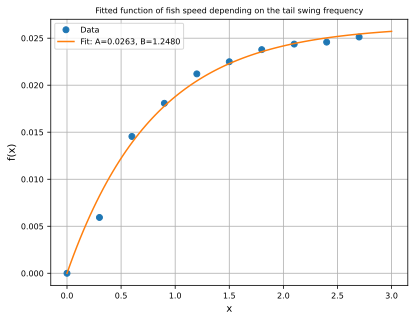

Velocity model: fitted parameters for exponential model: A=0.026345922081414008 B=1.2480317902279239


In [12]:
from scipy.optimize import curve_fit

# Velocity dynamics
ds = 0.3
propelling_fqs = []
velocities  = []

for i in range(0, int(physics_max_freq / ds)):
  physics.reset()

  freq = ds*i
  _, _, (dx, dy, dphi) = run_simulation(
      physics,
      pursuit_actuation=[freq, 0, 0],
      evasion_actuation=[0, 0, 0],
      max_duration=5,
  )
  propelling_fqs.append(freq)
  velocities.append(dy)

# Data collected from the simulation by applying only [phi, 0, 0] actuation
x = np.array(propelling_fqs)
y = np.array(velocities)

print(x)
print(y)

# Exponential model
def velocity_model(x, A, B):
    return A * (1 - np.exp(-B * x))

# Fit the model
params, _ = curve_fit(velocity_model, x, y)
A, B = params

# Plot
x_fit = np.linspace(0, 3, 100)
y_fit = velocity_model(x_fit, A, B)

plt.plot(x, y, 'o', label='Data')
plt.plot(x_fit, y_fit, '-', label=f'Fit: A={A:.4f}, B={B:.4f}')
plt.title('Fitted function of fish speed depending on the tail swing frequency')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.legend()
plt.grid(True)
plt.show()

print(f'Velocity model: fitted parameters for exponential model: A={A} B={B}')

### Restore model for fish velocity

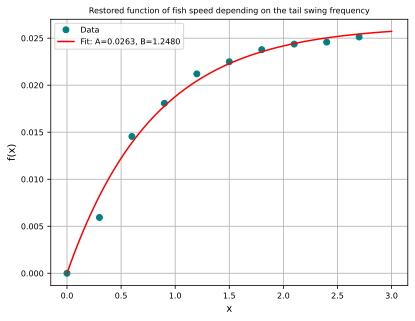

In [13]:
def velocity_model_restored(ω):
    """
    Function of fish speed depending on tail frequency
    """
    # fitted parameters
    A=0.026345922081414008
    B=1.2480317902279239
    return A * (1 - np.exp(-B * ω))

# Plot
x_fit = np.linspace(0, 3, 100)
y_fit = velocity_model_restored(x_fit)

x = [0., 0.3, 0.6, 0.9, 1.2 ,1.5, 1.8, 2.1, 2.4, 2.7]
y = [0., 0.00593589, 0.01454871, 0.01807576, 0.02120312, 0.0224939,\
 0.02378134, 0.02437043, 0.0245798, 0.02512477]

plt.plot(x, y, 'o', label='Data', color='teal')
plt.plot(x_fit, y_fit, '-', label=f'Fit: A={A:.4f}, B={B:.4f}', color='red')
plt.title('Restored function of fish speed depending on the tail swing frequency')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.legend()
plt.grid(True)
plt.show()

### Fit model for Angle Of Attack

In [ ]:
propelling_steering_fqs = []
angular_velocities = []

for i in range(int(2 * physics_max_freq / ds)):
  for j in range(int(2 * physics_max_freq / ds)):
    for k in range(int(2 * physics_max_freq / ds)):
      freq_i = -physics_max_freq + i * ds
      freq_j = -physics_max_freq + j * ds
      freq_k = -physics_max_freq + k * ds

      actuation = [freq_i, freq_j, freq_k]

      physics.reset()

      _, _, (dx, dy, dphi) = run_simulation(
          physics,
          pursuit_actuation=actuation,
          evasion_actuation=[0, 0, 0],
          max_duration=3,
      )
      propelling_steering_fqs.append(actuation)
      angular_velocities.append(dphi)

print(f'\nParameters: {propelling_steering_fqs}')
print(f'Angular velocities: {angular_velocities}')

Streaming output truncated to the last 5000 lines.
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 2.7
    steering_freq_left  : 1.5
    steering_freq_right : -3.0
  reward: 0.29945


Time=1000ms
  state:
    aoa            : 1.51879
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50166 -0.488  ]
  action:
    propelling_freq     : 2.7
    steering_freq_left  : 1.5
    steering_freq_right : -3.0
  reward: 0.30491


Time=2000ms
  state:
    aoa            : 1.66782
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50166 -0.4645 ]
  action:
    propelling_freq     : 2.7
    steering_freq_left  : 1.5
    steering_freq_right : -3.0
  reward: 0.3033

pursuit(2.7)=0.0235m/s                   evasion(0)=0.0000m/s                   dα([2.7, 1.5, -3.0])=0.14903

Time=3000ms
  state:
    aoa            : 1.63394
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50633 -0.44129]
  action:
  

X:
[[-3.  -3.  -3. ]
 [-3.  -3.  -2.7]
 [-3.  -3.  -2.4]
 ...
 [ 2.7  2.7  2.1]
 [ 2.7  2.7  2.4]
 [ 2.7  2.7  2.7]]

y: [0.01265033 0.00458096 0.01963478 ... 0.03283935 0.03283935 0.05286748]

Intercept: 0.11581644505894603
Coefficients: [ 0.00000000e+00  2.24974354e-03  3.94937048e-04  3.08181659e-04
 -7.05252731e-03  1.03031514e-05 -3.51107369e-05  2.38292533e-04
  3.42460635e-05  3.28857397e-04]


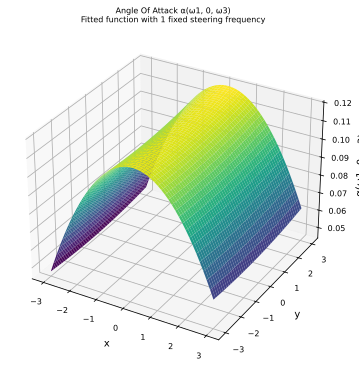

In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline

# Data collected from the simulation by applying all possible frequencies
# from -3 to 3 with step 0.5 [freq_i, freq_j, freq_k] actuation
X = np.array(propelling_steering_fqs)
y = np.array(angular_velocities)

print(f'X:\n{X}\n')
print(f'y: {y}\n')

# Fit a degree-2 polynomial
aoa_model = make_pipeline(PolynomialFeatures(degree=2), LinearRegression())
aoa_model.fit(X, y)

# Get predictions
y_pred = aoa_model.predict(X)

# Print formula
coeffs = aoa_model.named_steps['linearregression'].coef_
intercept = aoa_model.named_steps['linearregression'].intercept_
print("Intercept:", intercept)
print("Coefficients:", coeffs)

# Fix ω=0, vary ω1 and ω3
ω1_range = np.linspace(-physics_max_freq, physics_max_freq, 50)
ω2_fixed = 0
ω3_range = np.linspace(-physics_max_freq, physics_max_freq, 50)
x_grid, y_grid = np.meshgrid(ω1_range, ω3_range)

# Flatten grid and predict
X_plot = np.c_[x_grid.ravel(), y_grid.ravel(), np.full_like(x_grid.ravel(), ω2_fixed)]
y_pred = aoa_model.predict(X_plot).reshape(x_grid.shape)

# Plot
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x_grid, y_grid, y_pred, cmap='viridis')
ax.set_title("Angle Of Attack α(ω1, 0, ω3)\nFitted function with 1 fixed steering frequency")
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_zlabel(f"α(ω1, 0, ω3)")
plt.show()

In [ ]:
# Check if angular model works
print( aoa_model.predict(np.array([[0,0,0]])) )
print( aoa_model.predict(np.array([[3,0,0]])) )
print( aoa_model.predict(np.array([[3,0,3]])) )

[0.11581645]
[0.05909293]
[0.06266119]


### Restore model for Angle Of Attack

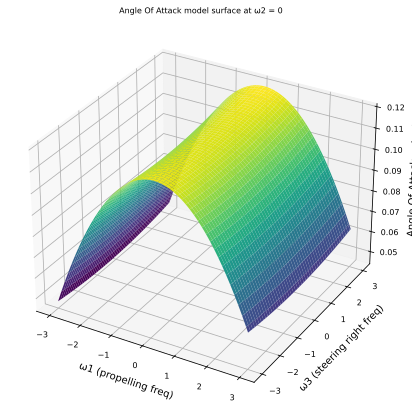

In [14]:
def aoa_function_restored(ω1, ω2, ω3):
    """
    Function of AoA change depending on tail frequency, and frequency
    of fins for left turn and right turn respectively
    """
    # Fitted parameters
    intercept = 0.11581644505894603
    coeffs = [
        2.24974354e-03,  # x
        3.94937048e-04,  # y
        3.08181659e-04,  # z
       -7.05252731e-03,  # x^2
        1.03031514e-05,  # x*y
       -3.51107369e-05,  # x*z
        2.38292533e-04,  # y^2
        3.42460635e-05,  # y*z
        3.28857397e-04   # z^2
    ]

    return (
        intercept
        + coeffs[0] * ω1
        + coeffs[1] * ω2
        + coeffs[2] * ω3
        + coeffs[3] * ω1**2
        + coeffs[4] * ω1 * ω2
        + coeffs[5] * ω1 * ω3
        + coeffs[6] * ω2**2
        + coeffs[7] * ω2 * ω3
        + coeffs[8] * ω3**2
    )

# Create a grid of x and y values
ω1 = np.linspace(-3, 3, 100)
ω2 = 0  # fix ω2 to visualize in 2D plane
ω3 = np.linspace(-3, 3, 100)
x_grid, y_grid = np.meshgrid(ω1, ω3)

# Evaluate the model
aoa_values = aoa_function_restored(x_grid, ω2, y_grid)

# Plot the surface
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x_grid, y_grid, aoa_values, cmap='viridis')

ax.set_xlabel("ω1 (propelling freq)")
ax.set_ylabel("ω3 (steering right freq)")
ax.set_zlabel("Angle Of Attack output")
ax.set_title("Angle Of Attack model surface at ω2 = 0")
plt.show()

In [15]:
# Check if angular model works
print( aoa_function_restored(0,0,0) )
print( aoa_function_restored(3,0,0) )
print( aoa_function_restored(3,0,3) )

0.11581644505894603
0.059092929888946044
0.06266119480684604


### Compile cost function for MPC

In [16]:
from numpy.linalg import norm

# Hyperparameters of the cost function:
w_dist = 1      # weight of distance in the cost value
w_angle = 0.7   # weight of Angle Of Attack in the cost value
w_ctrl = 0.3    # weight of control in the cost value

# Initial state
physics.reset()

def compute_mpc_cost(X, U, delta_t):
    """
    Computes cost for dynamic system using fitted models and weights

    X := (x, y, α)      - (x_pursuit, x_evasion, aoa)
    U := (u_prev, u_next)

    u := (ω1, ω2, ω3)   - (propelling_freq, left_steering_freq, right_steering_freq)
    θ := ν * delta_t

    J(X,U) = w_dist * norm( x - y )^2 + w_angle * (1 - cos(θ)) + w_ctrl * norm(Δu)^2

    x = x0 + dx
    dx = v(1) * delta_t         - fixed frequency for the "evader"

    y = y0 + dy
    dy = v(ω1) * delta_t        - actuated frequency for the "pursuit"

    v(ω1) = A*(1 - e^(-B * ω1)) - fitted model "velocity_model_restored"

    θ = α + φ(ω1, ω2, ω3) * delta_t               - Angle Of Attack dynamics
    φ = a0 + a1*ω1 + a2*ω2 + a3*ω3 + a4*ω1^2 ...  - fitted model "aoa_function_restored"

    Parameters:
      X = (x, y, α)         - positions of fish objects + Angle Of Attack
      U = (u_next, u_prev)  - tuple of two (3,) ndarray with next and prev actuation frequencies for "pursuit" fish
      delta_t               - time for which actuation "u" is applied
    """
    x, y, α = X
    u_prev, u_next = U

    ω1, ω2, ω3 = u_next
    distance = norm(x - y) - velocity_model_restored(ω1) * delta_t

    Δu = u_next - u_prev

    θ = α
    if np.abs(ω2) > ds or np.abs(ω3) > ds:
        φ = aoa_function_restored(ω1, ω2, ω3)
        θ = α + φ * delta_t

    # print(f'Compare:\n\
    #         d={distance}\n\
    #         d0={norm(x0 - y0)}\n\
    #         cos(AoA)={np.abs(np.cos(θ))}\n\
    #         cos(AoA0)={np.cos(aoa0)}')
    return w_dist * distance**2 + w_angle*(1 - np.abs(np.cos(θ))) + w_ctrl * norm(Δu)**2

# Test out cost function
duration = 50
x0, y0  = get_positions(physics)
aoa0    = get_aoa_rad(physics)

X0 = (x0, y0, aoa0)
u0 = np.array([0, 0, 0])

U1 = (u0, [2, 0, 0])
U2 = (u0, [2, 0, 1])

print(f'Initial cost: {compute_mpc_cost(X0, U1, 0)}')
print(f'Cost after {duration}s: {compute_mpc_cost(X0, U2, duration)}')

Initial cost: 3.1500000000000004
Cost after 50s: 1.5103972747044156


### MPC control law

In [17]:
def compute_sequence_cost(X, u, dt, actuation_sequence):
    """
    Computes a total cost of a sampled sequence
    """
    total_cost = 0.0
    x, y, α = X

    u_prev = u
    for u_next in actuation_sequence:
        U = (u_prev, u_next)

        total_cost += compute_mpc_cost(X, U, dt)

        prev_u = u_next

    return total_cost


############################################################################
# -------------------------- MPC control law -------------------------------
# -- Cross-Entropy Method for sampling actuation sequences for MPC (CEM) ---
############################################################################

def cross_entropy_mpc_control(
    X,
    u,
    dt,
    horizon,
    num_samples=100,
    num_elites=10,
    num_iters=5,
    init_std=1.0,
    time_correlation=0.9,        # Between 0 (independent) and 1 (fully smooth)
    seed=None,
):
    """
    Cross-Entropy Method (CEM) optimizer for action sequence selection with temporal correlation.
    Args:
        X: state of the system X = (x, y, α)
        u: actuation signal for the "pursuit" object
        horizon (int): Number of time steps in each action sequence.
        num_samples (int, optional): Number of candidate action sequences to sample per iteration. Default is 100.
        num_elites (int, optional): Number of top-performing sequences to use for updating the distribution. Default is 10.
        num_iters (int, optional): Number of optimization iterations. Default is 5.
        init_mean (np.ndarray, optional): Initial mean for the action sequence distribution. Shape: (horizon, action_dim).
            If None, initialized to zeros.
        init_std (float or np.ndarray, optional): Initial standard deviation for the action sequence distribution.
            Can be a scalar or array of shape (horizon, action_dim). Default is 1.0.
        time_correlation (float, optional): Temporal correlation coefficient for sampling action sequences.
            Value between 0 (independent noise) and 1 (fully correlated/smooth). Default is 0.9.
        seed (int, optional): Random seed for reproducibility. Default is None.
    Returns:
        tuple:
            - mean (np.ndarray): The optimized mean action sequence of shape (horizon, action_dim).
            - first_action (np.ndarray): The first action in the optimized sequence, shape (action_dim,).
    Notes:
        - The optimizer samples action sequences with temporal correlation, evaluates their costs,
          and iteratively refines the sampling distribution based on elite samples.
        - Useful for model-based control and planning in continuous action spaces.
    """
    action_dim = len(u)

    if seed is not None:
        np.random.seed(seed)

    # Initial mean and std for action sequences
    mean = u.copy()
    std = np.ones((horizon, action_dim)) * init_std

    # Build time correlation kernel
    def time_correlated_noise(std, rho):
        """Sample time-correlated Gaussian noise."""
        noise = np.random.randn(horizon, action_dim)
        for t in range(1, horizon):
            noise[t] = rho * noise[t - 1] + np.sqrt(1 - rho**2) * noise[t]
        return noise * std

    for i in range(num_iters):
        # Sample action sequences with temporal correlation
        samples = np.array([
            np.clip(mean + time_correlated_noise(std, time_correlation), -physics_max_freq, physics_max_freq)
            for _ in range(num_samples)
        ])  # Shape: (num_samples, horizon, action_dim)

        # Evaluate cost
        costs = np.array([
            compute_sequence_cost(X, u, dt, sampled_actuation_seq)
            for sampled_actuation_seq in samples
        ])

        # Select elites
        elite_idxs = np.argsort(costs)[:num_elites]
        elites = samples[elite_idxs]

        # Update mean and std
        mean = elites.mean(axis=0)
        std = elites.std(axis=0) + 1e-6  # Add epsilon for numerical stability

    normalize = lambda x: np.round(x * 2) / 2
    normalized_mean = [normalize(el) for el in mean]

    # Return best action sequence and the first action
    return normalized_mean, normalized_mean[0]

# Test out CEM
physics.reset()

x, y  = get_positions(physics)
α     = get_aoa_rad(physics)

best_seq, u = cross_entropy_mpc_control(
    X=(x, y, α),
    u=[2, 0, 2],
    dt=0.1,
    horizon=5,
    num_samples=20,
    num_elites=5,
    num_iters=5,
    init_std=1.0,
    time_correlation=0.8, # Between 0 (independent) and 1 (fully smooth)
    seed=42
)

print(f'Test CEM:\n\
        u={u}\n\
        Best sequence:\n\
        {best_seq}')

Test CEM:
        u=[2.5 0.  2. ]
        Best sequence:
        [array([2.5, 0. , 2. ]), array([ 2.5, -0. ,  2. ]), array([2.5, 0. , 2. ]), array([2., 0., 2.]), array([ 2.5, -0. ,  2. ])]


### Test MPC control

In [18]:
def mpc_control_fn(X, u, dt):
  best_seq, u_optimal = cross_entropy_mpc_control(
    X,
    u,
    dt,
    horizon=10,
    num_samples=30,
    num_elites=5,
    num_iters=10,
    init_std=0.8,
    time_correlation=0.7, # Between 0 (independent) and 1 (fully smooth)
    seed=42
  )
  print(f'u={u}')
  print(f'u_optimal={u_optimal}')
  return u_optimal

In [24]:
# Test MPC control in the simulation
fps = 30
frames, _, _ = run_simulation(
      physics,
      pursuit_actuation=[2, 0, 0],
      evasion_actuation=[0, 0, 0],
      max_duration=50,
      fps=fps,
      eps=0.1,
      mpc_control_fn=mpc_control_fn,
      rendering={
          "camera_ids": [
              'tracking_top',
              'tracking_x',
              'tracking_y',
              "pursuit_eye"
              ],
          "cam_width": 640,
          "cam_height": 480,
          "grid_rows": 2,
          "grid_cols": 2,
      }
  )
display_video(frames, fps)


Time=0ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 1.0
    steering_freq_right : 0.0
  reward: 0.29945


Time=1000ms
  state:
    aoa            : 1.56309
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50122 -0.49109]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 1.0
    steering_freq_right : 0.0
  reward: 0.30197


Time=2000ms
  state:
    aoa            : 1.57024
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50262 -0.47384]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 1.0
    steering_freq_right : 0.0
  reward: 0.30572

pursuit(2)=0.0173m/s                   evasion(0)=0.0000m/s                   dα([2, 1, 0])=0.00715
u=[2, 1, 0]
u_optimal=[2. 1. 0.]

Time=3000ms
  state:
    aoa            : 1.57791
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50419 -0.45588]
  action:
    propelli

# Data collection for Trajectory Transformer

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

DATA_DIR = '/content/drive/MyDrive/deep-learning/trajectories'

Mounted at /content/drive


In [ ]:
import time

# Measure time of simulation with MPC to have an idea how long would it take

start_time = time.perf_counter()

_, traj, _ = run_simulation(
    physics,
    pursuit_actuation=u,
    evasion_actuation=[1, 0, 0],
    max_duration=45,
    eps=0.1,
    mpc_control_fn=mpc_control_fn
)

end_time = time.perf_counter()
t = (end_time - start_time) * 1e3

print(f'Time with MPC {t:.2f}ms')


Time=0ms
  state:
    aoa            : 1.5708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.5 -0.5]
  action:
    propelling_freq     : 2.5
    steering_freq_left  : 0.0
    steering_freq_right : 2.0
  reward: 0.29945


Time=1000ms
  state:
    aoa            : 1.47717
    x_evasion      : [-0.99393  0.49913]
    x_pursuit      : [-0.50103 -0.49144]
  action:
    propelling_freq     : 2.5
    steering_freq_left  : 0.0
    steering_freq_right : 2.0
  reward: 0.3071


Time=2000ms
  state:
    aoa            : 1.50973
    x_evasion      : [-0.9776   0.49902]
    x_pursuit      : [-0.49697 -0.47441]
  action:
    propelling_freq     : 2.5
    steering_freq_left  : 0.0
    steering_freq_right : 2.0
  reward: 0.31076

pursuit(2.5)=0.0170m/s                   evasion(1)=0.0163m/s                   dα([2.5 0.  2. ])=0.03255
u=[2.5 0.  2. ]
u_optimal=[ 2.5 -0.5  2. ]

Time=3000ms
  state:
    aoa            : 1.44122
    x_evasion      : [-0.95898  0.49889]
    x_pursuit      : [-0

In [ ]:
simulated_trajectories = []

iter = 0

# Collect trajectory data for traning dataset by simulating over various
# configurations of ω1, ω2, ω3
for ω1 in np.arange(0.5, 2.5, 0.5):     # [0.5, 2] inclusive
  for ω2 in np.arange(-1, 1.5, 0.5):    # [-1 , 1] inclusive
    for ω3 in np.arange(-1, 1.5, 0.5):  # [-1 , 1] inclusive
      u = [ω1, ω2, ω2]

      physics.reset()

      _, traj, _ = run_simulation(
          physics,
          pursuit_actuation=u,
          evasion_actuation=[1, 0, 0],
          max_duration=45,
          eps=0.1,
          mpc_control_fn=mpc_control_fn
      )
      trajectory = compile_trajectory(traj)

      simulated_trajectories.append(trajectory)

      iter += 1
      print(f'-------- In progress: {iter} --------')


save_path = f"{DATA_DIR}/trajectory_data_mpc.npz"
np.savez(save_path, data=np.array(simulated_trajectories))
print(f"Saved to {save_path}")

Streaming output truncated to the last 5000 lines.
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 0.5
    steering_freq_right : 0.5
  reward: 0.36567

pursuit(2.0)=0.0208m/s                   evasion(1)=0.0192m/s                   dα([2.  0.5 0.5])=0.00396

Time=10000ms
  state:
    aoa            : 1.50713
    x_evasion      : [-0.82475  0.4979 ]
    x_pursuit      : [-0.49517 -0.30454]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 0.5
    steering_freq_right : 0.5
  reward: 0.37421

pursuit(2.0)=0.0207m/s                   evasion(1)=0.0192m/s                   dα([2.  0.5 0.5])=0.00336
u=[2.  0.5 0.5]
u_optimal=[2.  0.5 0.5]

Time=11000ms
  state:
    aoa            : 1.5032
    x_evasion      : [-0.80555  0.49775]
    x_pursuit      : [-0.49435 -0.28373]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : 0.5
    steering_freq_right : 0.5
  reward: 0.38303

pursuit(2.0)=0.0208m/s                   evasion(1)=0.0192m/s            

# Training Trajectory Transformer

### Data loading and preprocessing

In [ ]:
!pip install 'transformers==4.30.0'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.6/113.6 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 89.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 139.7 MB/s eta 0:00:00
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.21.1
    Uninstalling tokenizers-0.21.1:
      Successfully uninstalled tokenizers-0.21.1
  Attempting uninstall: transformers
    Found existing installation: transformers 4.51.3
    Uninstalling transformers-4.51.3:
      Successfully uninstalled transformers-4.51.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sentence-transformers 4.1.0 requires transformers<5.0.0,>=4.41.0, but you have transformers 4.30.0 which is incompatible.


In [ ]:
save_path = f"{DATA_DIR}/trajectory_data_mpc.npz"

# Load the data from npz file
data = np.load(save_path, allow_pickle=True)

# Access the array under the "data" key
trajectories_raw = data["data"]

print(type(trajectories_raw))     # should be a numpy array
print(len(trajectories_raw))      # number of trajectories
print(trajectories_raw[0].shape)  # shape of one trajectory, likely (T, D)

<class 'numpy.ndarray'>
100
(46, 9)


In [ ]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader

state_dim = 5
action_dim = 3
batch_size = 32
seq_len = 20

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class TTMDataset(torch.utils.data.Dataset):
    def __init__(self, trajectories, state_dim, action_dim, seq_len, batch_size):
        self.data = []
        self.seq_len = seq_len
        self.batch_size = batch_size

        for traj in trajectories:
            states = traj[:, :state_dim]
            actions = traj[:, state_dim:state_dim+action_dim]
            rewards = traj[:, -1]
            rtgs = rewards.copy()
            timesteps = np.arange(len(traj))

            for i in range(len(traj) - seq_len):
                self.data.append((
                    states[i:i+seq_len],
                    actions[i:i+seq_len],
                    rewards[i:i+seq_len],
                    rtgs[i:i+seq_len],
                    timesteps[i:i+seq_len]
                ))

    def __len__(self):
        return len(self.data)


    def __getitem__(self, idx):
        s, a, r, rtg, t = self.data[idx]
        return {
            'states': torch.tensor(s, dtype=torch.float32),
            'actions': torch.tensor(a, dtype=torch.float32),
            'rewards': torch.tensor(r, dtype=torch.float32),
            'rtgs': torch.tensor(rtg, dtype=torch.float32),
            'timesteps': torch.tensor(t, dtype=torch.long)
        }

    def size(self):
        return self.batch_size, self.seq_len

    @property
    def shape(self):
        return (self.batch_size, len(self.data))

    @property
    def device(self):
        return device

# Create Dataset and DataLoader
dataset = TTMDataset(
    trajectories_raw,
    state_dim,
    action_dim,
    seq_len=seq_len,
    batch_size=batch_size,
)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Example usage
traj_item = next(iter(dataloader))
print(traj_item['states'].shape)
dataset.size()

torch.Size([32, 20, 5])


(32, 20)

### Model training

In [ ]:
from transformers.models.trajectory_transformer import TrajectoryTransformerModel, TrajectoryTransformerConfig

config = TrajectoryTransformerConfig(
    observation_dim=5,
    action_dim=3,
    n_embd=128,
    n_layer=4,
    n_head=4,
    attn_pdrop=0.1
)

model = TrajectoryTransformerModel(config)
model.to(device)
print(model)

TrajectoryTransformerModel(
  (tok_emb): Embedding(2501, 128)
  (drop): Dropout(p=0.1, inplace=False)
  (blocks): ModuleList(
    (0-3): 4 x Block(
      (ln1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
      (ln2): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
      (attn): CausalSelfAttention(
        (key): Linear(in_features=128, out_features=128, bias=True)
        (query): Linear(in_features=128, out_features=128, bias=True)
        (value): Linear(in_features=128, out_features=128, bias=True)
        (attn_drop): Dropout(p=0.1, inplace=False)
        (resid_drop): Dropout(p=0.1, inplace=False)
        (proj): Linear(in_features=128, out_features=128, bias=True)
      )
      (l1): Linear(in_features=128, out_features=512, bias=True)
      (act): GELU(approximate='none')
      (l2): Linear(in_features=512, out_features=128, bias=True)
      (drop): Dropout(p=0.1, inplace=False)
    )
  )
  (ln_f): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
  (head):

In [ ]:
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
loss_fn = torch.nn.MSELoss()

for epoch in range(10):  # Or more
    model.train()
    total_loss = 0.0
    for batch in dataloader:
        states = batch["states"].to(device)
        actions = batch["actions"].to(device)

        optimizer.zero_grad()

        # Use input embeddings if needed or pass as inputs directly
        outputs = model(states).last_hidden_state
        print(outputs)

        # You may need to slice or process `outputs` to match `actions` shape
        pred_actions = outputs[:, -actions.shape[1]:, :actions.shape[2]]

        loss = loss_fn(pred_actions, actions)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(dataloader)
    print(f"Epoch {epoch + 1}, Loss: {avg_loss:.4f}")

model.save_pretrained('tt_fish_pursuit')

ValueError: too many values to unpack (expected 2)

# Comparing results

### MPC with cross-entropy

Streaming output truncated to the last 5000 lines.

pursuit(2.0)=0.0240m/s                   evasion(1)=0.0192m/s                   dα([ 2. -0. -1.])=0.00000

Time=8000ms
  state:
    aoa            : 1.51598
    x_evasion      : [-0.86314  0.49818]
    x_pursuit      : [-0.50303 -0.32233]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : -0.0
    steering_freq_right : -1.0
  reward: 0.36466

pursuit(2.0)=0.0240m/s                   evasion(1)=0.0192m/s                   dα([ 2. -0. -1.])=0.00000
u=[ 2. -0. -1.]
u_optimal=[ 2. -0. -1.]

Time=9000ms
  state:
    aoa            : 1.51598
    x_evasion      : [-0.84394  0.49804]
    x_pursuit      : [-0.50341 -0.29835]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : -0.0
    steering_freq_right : -1.0
  reward: 0.37419

pursuit(2.0)=0.0240m/s                   evasion(1)=0.0192m/s                   dα([ 2. -0. -1.])=0.00000

Time=10000ms
  state:
    aoa            : 1.51598
    x_evasion      : [-0.82475

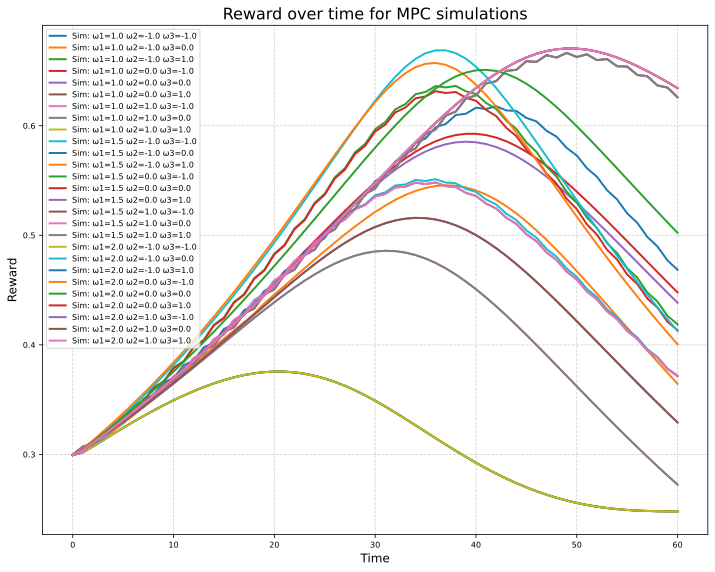

In [ ]:
x = range(0, 61)

plt.figure(figsize=(10, 8))

for ω1 in np.arange(1, 2.5, 0.5):     # 3
  for ω2 in np.arange(-1, 1.5, 1):    # 3
    for ω3 in np.arange(-1, 1.5, 1):  # 3
      physics.reset()

      _, traj, _ = run_simulation(
        physics,
        pursuit_actuation=[ω1, ω2, ω3],
        evasion_actuation=[1, 0, 0],
        max_duration=60,
        eps=0.1,
        mpc_control_fn=mpc_control_fn,
      )
      y = traj['rewards']
      plt.plot(x, y, label=f'Sim: ω1={ω1} ω2={ω2} ω3={ω3}', linewidth=2)

# Styling
plt.title("Reward over time for MPC simulations", fontsize=16)
plt.xlabel("Time", fontsize=12)
plt.ylabel("Reward", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend()
plt.tight_layout()

plt.show()

### MPC with Trajectory Transformer

In [ ]:
from transformers.models.trajectory_transformer import TrajectoryTransformer

model = TrajectoryTransformer.from_pretrained('tt_fish_pursuit')

def compute_reward_estimates(predicted_trajectory):
    return np.sum([traj_el[-1] for traj_el in predicted_trajectory])

def mpc_control_with_transformer(state, horizon, num_samples, num_elites):
    action_dim = model.action_dim
    candidate_actions = torch.randn((num_samples, horizon, action_dim), device=state.device)

    states = state.repeat(num_samples, 1)

    trajectories = []
    for t in range(horizon):
        state_action = torch.cat([states, candidate_actions[:, t]], dim=-1)
        trajectories.append(state_action)

    input_seq = torch.stack(trajectories, dim=1)

    with torch.no_grad():
        pred = model(inputs_embeds=input_seq).last_hidden_state

    scores = compute_reward_estimates(pred)

    best_actions = candidate_actions[scores.topk(num_elites).indices]
    mean_action = best_actions.mean(dim=0)

    return mean_action[0]

def mpc_tt_control_fn(X, u, dt):
    u_optimal = mpc_control_with_transformer(
      X,
      horizon=10,
      num_samples=30,
      num_elites=5,
    )
    print(f'u={u}')
    print(f'u_optimal={u_optimal}')
    return u_optimal


ImportError: cannot import name 'TrajectoryTransformer' from 'transformers.models.trajectory_transformer' (/usr/local/lib/python3.11/dist-packages/transformers/models/trajectory_transformer/__init__.py)

Streaming output truncated to the last 5000 lines.

pursuit(2.0)=0.0240m/s                   evasion(0)=0.0000m/s                   dα([ 2. -0. -1.])=0.00000

Time=8000ms
  state:
    aoa            : 1.55708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50303 -0.32233]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : -0.0
    steering_freq_right : -1.0
  reward: 0.34292

pursuit(2.0)=0.0240m/s                   evasion(0)=0.0000m/s                   dα([ 2. -0. -1.])=0.00000
u=[ 2. -0. -1.]
u_optimal=[ 2. -0. -1.]

Time=9000ms
  state:
    aoa            : 1.55708
    x_evasion      : [-1.   0.5]
    x_pursuit      : [-0.50341 -0.29835]
  action:
    propelling_freq     : 2.0
    steering_freq_left  : -0.0
    steering_freq_right : -1.0
  reward: 0.34906

pursuit(2.0)=0.0240m/s                   evasion(0)=0.0000m/s                   dα([ 2. -0. -1.])=0.00000

Time=10000ms
  state:
    aoa            : 1.55708
    x_evasion      : [-1.   0.5]
    x_pursuit

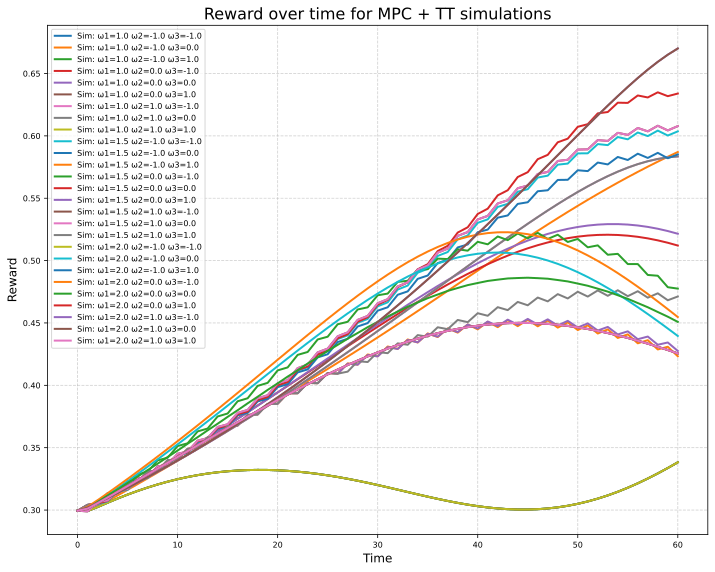

In [ ]:
x = range(0, 61)

plt.figure(figsize=(10, 8))

for ω1 in np.arange(1, 2.5, 0.5):     # 3
  for ω2 in np.arange(-1, 1.5, 1):    # 3
    for ω3 in np.arange(-1, 1.5, 1):  # 3
      physics.reset()

      _, traj, _ = run_simulation(
        physics,
        pursuit_actuation=[ω1, ω2, ω3],
        evasion_actuation=[1, 0, 0],
        max_duration=60,
        eps=0.1,
        mpc_control_fn=mpc_tt_control_fn,
      )
      y = traj['rewards']
      plt.plot(x, y, label=f'Sim: ω1={ω1} ω2={ω2} ω3={ω3}', linewidth=2)

# Styling
plt.title("Reward over time for MPC + TT simulations", fontsize=16)
plt.xlabel("Time", fontsize=12)
plt.ylabel("Reward", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend()
plt.tight_layout()

plt.show()